<a href="https://colab.research.google.com/github/rose72001/Firstrepo/blob/main/IP_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [10]:
from google.colab import files

print("Please upload 'Einstein.jpg' when the button appears below:")
uploaded = files.upload()


filename = next(iter(uploaded))
print(f"✅ File uploaded: {filename}")

Please upload 'Einstein.jpg' when the button appears below:


Saving Einstein.jpg to Einstein.jpg
✅ File uploaded: Einstein.jpg


✅ Image loaded successfully!


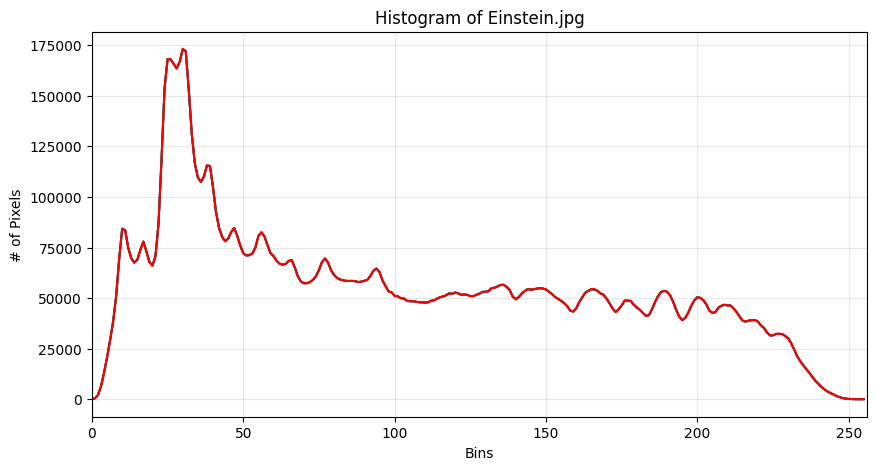

Original Image:


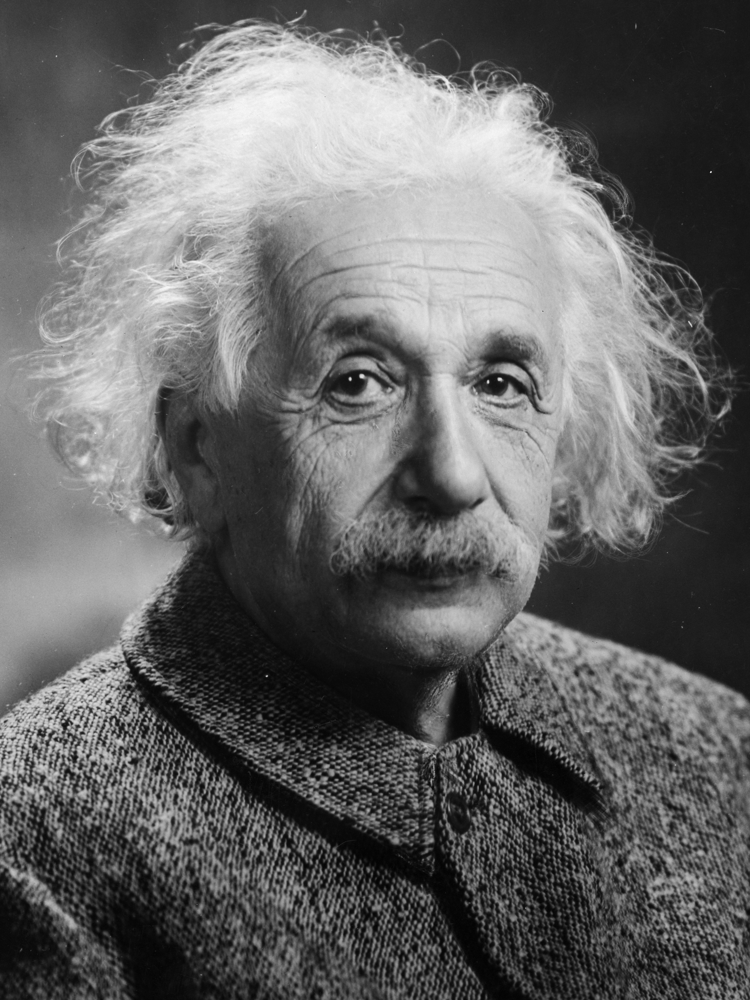


Equalized Image:


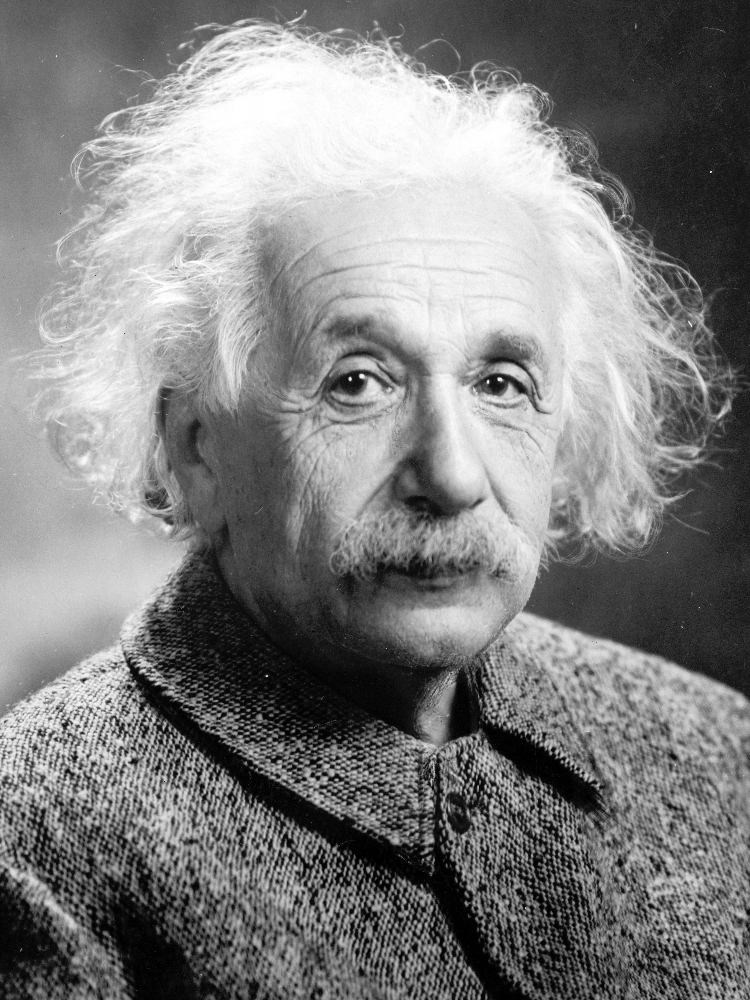

In [11]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow # Required for Colab

def process_uploaded_image(filename):

    img = cv2.imread(filename)

    if img is None:
        print(f"❌ Error: Could not load '{filename}'. Make sure the name matches exactly what you uploaded.")
        return

    print("✅ Image loaded successfully!")


    plt.figure(figsize=(10, 5))
    plt.title(f"Histogram of {filename}")
    plt.xlabel("Bins")
    plt.ylabel("# of Pixels")

    colors = ('b', 'g', 'r')
    for i, color in enumerate(colors):
        hist = cv2.calcHist([img], [i], None, [256], [0, 256])
        plt.plot(hist, color=color)
        plt.xlim([0, 256])

    plt.grid(True, alpha=0.3)
    plt.show()


    img_ycrcb = cv2.cvtColor(img, cv2.COLOR_BGR2YCrCb)
    y_channel, cr_channel, cb_channel = cv2.split(img_ycrcb)

    y_equalized = cv2.equalizeHist(y_channel)

    img_ycrcb_eq = cv2.merge((y_equalized, cr_channel, cb_channel))
    img_final = cv2.cvtColor(img_ycrcb_eq, cv2.COLOR_YCrCb2BGR)


    print("Original Image:")
    cv2_imshow(img)

    print("\nEqualized Image:")
    cv2_imshow(img_final)


process_uploaded_image("Einstein.jpg")